In [1]:
!pip install lasio

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import plotly
import plotly.express as px

import lasio as las

data = las.read('demo.las')
log = data.df()

# len(log.columns)
log.columns

# data.curves

## Vp & AI

log['Vp'] = (1e6 / log['DT']) * 0.3048
# in m/s

log['AI'] = log['Vp'] * log['RHOB'] * 1000

log['Vp'].isna().sum()

log['M'] = log['RHOB']*1000*(log['Vp']**2)

In [3]:
# log.Vp
log = log.dropna()
# log

### ..

In [4]:
# depth intrval
start_depth = 800
end_depth = 1000

log_int = log.loc[(log.index >= start_depth) & (log.index <= end_depth)]

In [5]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# logs
curves = ['GR', 'RHOB', 'NPHI', 'DT', 'Vp', 'AI']
n_tracks = len(curves)

fig = make_subplots(
    rows=1, cols=n_tracks,
    shared_yaxes=True,
    horizontal_spacing=0.02
)

for i, curve in enumerate(curves):
    fig.add_trace(
        go.Scatter(
            x=log[curve],
            y=log.index,
            mode='lines',
            name=curve,
            line=dict(width=1)
        ),
        row=1, col=i + 1
    )

    fig.update_yaxes(
        autorange='reversed',
        title='Depth (m)' if i == 0 else None,
        row=1, col=i + 1
    )

    if i > 0:
        fig.update_yaxes(showticklabels=False, row=1, col=i + 1)

    # lables at top
    axis_name = f'xaxis{i + 1}' if i > 0 else 'xaxis'
    fig.update_layout({
        axis_name: dict(
            side='top',
            title=curve,
            title_standoff=10
        )
    })

fig.update_layout(
    height=800,
    # title_text="Well Logs",
    showlegend=False,
    template="plotly_white"
)

fig.show()


In [6]:
import seaborn as sns
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Predefined intervals
depth_intervals = [
    (800, 900),
    (900, 1000),
    (1000, 1100),
    (1100, 1200),
    (1200, 1300),
    (1300, 1400),
    (1400, 1500),
    (1500, 1600),
    (1600, 1700)
]

curves = ['GR', 'RHOB', 'NPHI', 'DT', 'Vp', 'AI']
n_tracks = len(curves)

#figure & add traces for each interval
fig = make_subplots(
    rows=1, cols=n_tracks,
    shared_yaxes=True,
    horizontal_spacing=0.02
)

buttons = []

for idx, (start_depth, end_depth) in enumerate(depth_intervals):
    vis = [False] * (len(depth_intervals) * len(curves))
    for i, curve in enumerate(curves):
        depth_filtered = log[(log.index >= start_depth) & (log.index <= end_depth)]

        fig.add_trace(
            go.Scatter(
                x=depth_filtered[curve],
                y=depth_filtered.index,
                mode='lines',
                name=f'{curve} ({start_depth}-{end_depth})',
                line=dict(width=1),
                visible=(idx == 0)  #first interval initially
            ),
            row=1, col=i + 1
        )
        vis[idx * len(curves) + i] = True

    buttons.append(dict(
        label=f"{start_depth}-{end_depth} m",
        method="update",
        args=[{"visible": vis}]
    ))

for i, curve in enumerate(curves):
    fig.update_yaxes(
        autorange='reversed',
        title='Depth (m)' if i == 0 else None,
        row=1, col=i + 1
    )
    if i > 0:
        fig.update_yaxes(showticklabels=False, row=1, col=i + 1)

    axis_name = f'xaxis{i + 1}' if i > 0 else 'xaxis'
    fig.update_layout({
        axis_name: dict(
            side='top',
            title=curve,
            title_standoff=10
        )
    })

fig.update_layout(
    height=800,
    showlegend=False,
    template="plotly_white",
    updatemenus=[
        dict(
            active=0,
            buttons=buttons,
            x=0.5,
            xanchor="center",
            y=1.15,
            yanchor="top"
        )
    ]
)

fig.show()


In [7]:
logs_to_plot = ['GR', 'DT', 'NPHI']
n_tracks = len(logs_to_plot)
depth = log.index.to_numpy()

fig = make_subplots(
    rows=1, cols=n_tracks,
    shared_yaxes=True,
    horizontal_spacing=0.05
)

colorscales = {
    'GR': 'spectral',
    'DT': 'spectral',
    'NPHI': 'spectral'
}

for i, curve in enumerate(logs_to_plot):
    x_vals = log[curve].to_numpy()
    
    z = np.tile(x_vals.reshape(-1, 1), (1, 2))
    x_range = [0, x_vals.max()]  # for heatmap

    fig.add_trace(
        go.Heatmap(
            z=z,
            x=x_range,
            y=depth,
            colorscale=colorscales[curve],
            showscale=False,
            zmin=np.nanmin(x_vals),
            zmax=np.nanmax(x_vals),
            hoverinfo='skip'
        ),
        row=1, col=i + 1
    )

    # Overlay
    fig.add_trace(
        go.Scatter(
            x=x_vals,
            y=depth,
            mode='lines',
            line=dict(color='black', width=1.5),
            name=curve,
            showlegend=False
        ),
        row=1, col=i + 1
    )

    fig.update_yaxes(
        autorange='reversed',
        title='Depth (m)' if i == 0 else None,
        showticklabels=(i == 0),
        row=1, col=i + 1
    )
    fig.update_xaxes(title=curve, row=1, col=i + 1)

    # lables and log scale
    axis_name = f'xaxis{i + 1}' if i > 0 else 'xaxis'
    fig.update_layout({
        axis_name: dict(
            side='top',
            title=curve,
            title_standoff=10
        )
    })

# Layout settings
fig.update_layout(
    height=900,
    # title="logs",
    template="plotly_white"
)

fig.show()


In [8]:
logs_to_plot = ['GR', 'DT', 'NPHI']
n_tracks = len(logs_to_plot)

colorscales = {
    'GR': 'spectral',
    'DT': 'spectral',
    'NPHI': 'spectral'
}

fig = make_subplots(
    rows=1, cols=n_tracks,
    shared_yaxes=True,
    horizontal_spacing=0.05
)

# dropdown button
buttons = []
traces_per_interval = len(logs_to_plot) * 2  # heatmap + line per curve

for idx, (start_depth, end_depth) in enumerate(depth_intervals):
    log_int = log[(log.index >= start_depth) & (log.index <= end_depth)]
    depth = log_int.index.to_numpy()

    for i, curve in enumerate(logs_to_plot):
        x_vals = log_int[curve].to_numpy()
        z = np.tile(x_vals.reshape(-1, 1), (1, 2))
        x_range = [0, np.nanmax(x_vals)]

        # Heatmap trace
        fig.add_trace(
            go.Heatmap(
                z=z,
                x=x_range,
                y=depth,
                colorscale=colorscales[curve],
                showscale=False,
                zmin=np.nanmin(x_vals),
                zmax=np.nanmax(x_vals),
                hoverinfo='skip',
                visible=(idx == 0)
            ),
            row=1, col=i + 1
        )

        # Line overlay trace
        fig.add_trace(
            go.Scatter(
                x=x_vals,
                y=depth,
                mode='lines',
                line=dict(color='black', width=1.5),
                name=curve,
                showlegend=False,
                visible=(idx == 0)
            ),
            row=1, col=i + 1
        )

# Dropdown buttons
for idx in range(len(depth_intervals)):
    vis = [False] * (traces_per_interval * len(depth_intervals))
    for i in range(traces_per_interval):
        vis[idx * traces_per_interval + i] = True

    label = f"{depth_intervals[idx][0]}-{depth_intervals[idx][1]} m"
    buttons.append(dict(
        label=label,
        method="update",
        args=[{"visible": vis}]
    ))

# Axis and layout config
for i, curve in enumerate(logs_to_plot):
    fig.update_yaxes(
        autorange='reversed',
        title='Depth (m)' if i == 0 else None,
        showticklabels=(i == 0),
        row=1, col=i + 1
    )
    fig.update_xaxes(title=curve, row=1, col=i + 1)

    axis_name = f'xaxis{i + 1}' if i > 0 else 'xaxis'
    fig.update_layout({
        axis_name: dict(
            side='top',
            title=curve,
            title_standoff=10
        )
    })

fig.update_layout(
    height=900,
    template="plotly_white",
    updatemenus=[
        dict(
            active=0,
            buttons=buttons,
            x=0.5,
            xanchor="center",
            y=1.15,
            yanchor="top"
        )
    ]
)

fig.show()


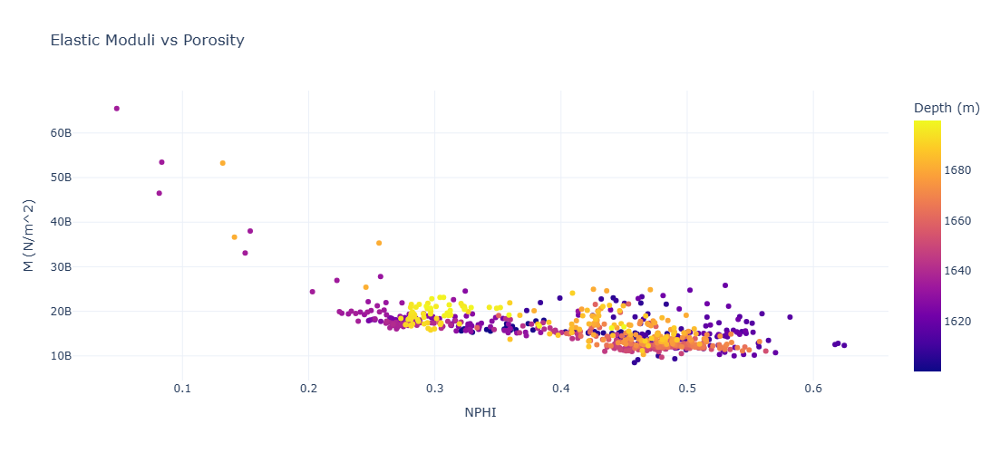

In [9]:
crossplot_data = log_int[['M', 'NPHI']].dropna().copy()
crossplot_data['Depth'] = log_int.index

fig = px.scatter(
    crossplot_data,
    x='NPHI',
    y='M',
    color='Depth',    
    # hover_data=['RHOB', 'GR'],
    title="Elastic Moduli vs Porosity",
    labels={'NPHI': 'NPHI', 'M': 'M (N/m^2)'},
    height=500, width=500
)

fig.update_layout(coloraxis_colorbar=dict(title='Depth (m)'), template="plotly_white")
fig.show()

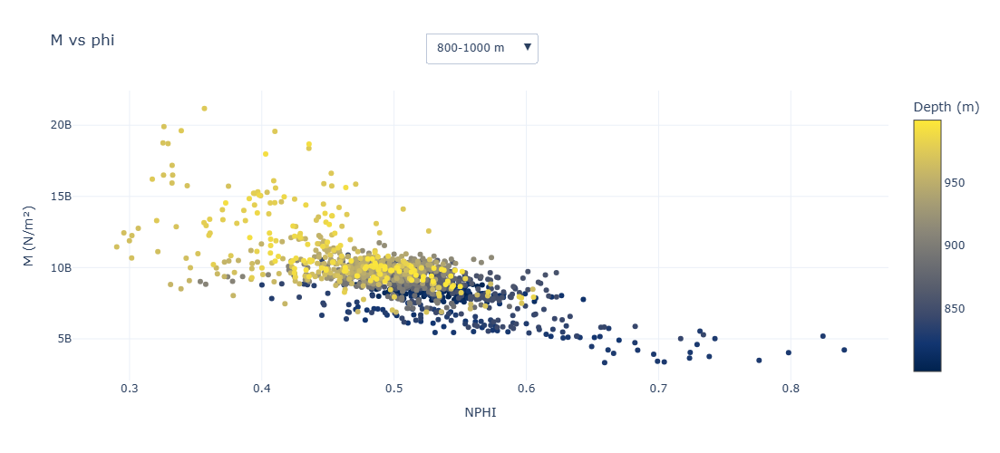

In [10]:
import plotly.graph_objects as go

# Predefined depth intervals
depth_intervals = [
    (800, 1000),
    (1000, 1200),
    (1200, 1400)
]

fig = go.Figure()
buttons = []

for idx, (start_depth, end_depth) in enumerate(depth_intervals):
    # Filter from full log data
    mask = (log.index >= start_depth) & (log.index <= end_depth)
    crossplot_data = log.loc[mask, ['M', 'NPHI']].dropna()
    depth = crossplot_data.index

    fig.add_trace(
        go.Scatter(
            x=crossplot_data['NPHI'],
            y=crossplot_data['M'],
            mode='markers',
            marker=dict(
                color=depth,
                colorscale='cividis',
                colorbar=dict(title='Depth (m)') if idx == 0 else None,
                showscale=(idx == 0),
                size=6
            ),
            name=f"{start_depth}-{end_depth} m",
            showlegend=False,
            visible=(idx == 0)
        )
    )

    # Visibility list
    vis = [False] * len(depth_intervals)
    vis[idx] = True

    buttons.append(dict(
        label=f"{start_depth}-{end_depth} m",
        method="update",
        args=[
            {"visible": vis},
            {"title": f"Elastic Moduli vs Porosity ({start_depth}-{end_depth} m)"}
        ]
    ))

# Layout
fig.update_layout(
    title="M vs phi",
    xaxis_title="NPHI",
    yaxis_title="M (N/m²)",
    height=500,
    width=500,
    template="plotly_white",
    updatemenus=[
        dict(
            buttons=buttons,
            direction='down',
            showactive=True,
            x=0.5,
            xanchor="center",
            y=1.2,
            yanchor="top"
        )
    ]
)

fig.show()


In [11]:
import dash
from dash import dcc, html, Input, Output
import plotly.graph_objs as go


crossplot_data = log_int[['M', 'NPHI']].dropna().copy()
crossplot_data['Depth'] = crossplot_data.index

depth_colors = crossplot_data['Depth']

# Initializing Dash
app = dash.Dash(__name__)

app.layout = html.Div([
    html.H4(" "),
    dcc.Graph(
        id='crossplot',
        config={'editable': True},
        figure={
            'data': [
                go.Scatter(
                    x=crossplot_data['NPHI'],
                    y=crossplot_data['M'],
                    mode='markers',
                    marker=dict(
                        color=depth_colors,
                        colorscale='Viridis',
                        colorbar=dict(title='Depth (m)'),
                        opacity=0.7,
                        size=8,
                    ),
                    name='Data points'
                )
            ],
            'layout': go.Layout(
                dragmode='drawline',
                newshape=dict(line_color='red'),
                title='curve fit',
                xaxis_title='NPHI',
                yaxis_title='M (N/m2)',
                template='plotly_white',
                height=800,
                width=800,
            )
        }
    ),
    html.Div(id='line-params')
])

@app.callback(
    Output('line-params', 'children'),
    Input('crossplot', 'relayoutData'),
    prevent_initial_call=True
)
def extract_line_params(relayout_data):
    if relayout_data and 'shapes' in relayout_data:
        shapes = relayout_data['shapes']
        lines_info = []
        for i, shape in enumerate(shapes):
            if all(k in shape for k in ['x0', 'x1', 'y0', 'y1']):
                x0, x1 = shape['x0'], shape['x1']
                y0, y1 = shape['y0'], shape['y1']
                if x1 != x0:
                    slope = (y1 - y0) / (x1 - x0)
                    intercept = y0 - slope * x0
                    lines_info.append(f"Line {i+1}: y = {slope:.2f} * x + {intercept:.2f}")
                else:
                    lines_info.append(f"Line {i+1}: Vertical line at x = {x0:.2f}")
        return html.Ul([html.Li(line) for line in lines_info])
    return "curve relation"

if __name__ == '__main__':
    app.run(debug=True)


In [12]:
import dash
from dash import dcc, html, Input, Output
import plotly.graph_objs as go
import pandas as pd

# Define depth intervals
depth_intervals = [
    (800, 1000),
    (1000, 1200),
    (1200, 1400)
]

# Initialize Dash app
app = dash.Dash(__name__)
server = app.server  # For deployment

# Layout
app.layout = html.Div([
    html.H4("Elastic Moduli vs Porosity"),
    
    dcc.Dropdown(
        id='depth-dropdown',
        options=[
            {'label': f'{start}-{end} m', 'value': f'{start}-{end}'}
            for start, end in depth_intervals
        ],
        value='800-1000',
        clearable=False,
        style={'width': '300px', 'margin-bottom': '10px'}
    ),

    dcc.Graph(
        id='crossplot',
        config={'editable': True},
        style={'height': '800px', 'width': '800px'}
    ),

    html.Div(id='line-params')
])

# Callback to update figure based on dropdown
@app.callback(
    Output('crossplot', 'figure'),
    Input('depth-dropdown', 'value')
)
def update_figure(selected_interval):
    start_depth, end_depth = map(int, selected_interval.split('-'))
    mask = (log.index >= start_depth) & (log.index <= end_depth)
    crossplot_data = log.loc[mask, ['M', 'NPHI']].dropna()
    depth = crossplot_data.index

    scatter = go.Scatter(
        x=crossplot_data['NPHI'],
        y=crossplot_data['M'],
        mode='markers',
        marker=dict(
            color=depth,
            colorscale='cividis',
            colorbar=dict(title='Depth (m)'),
            opacity=0.7,
            size=8,
        ),
        name='Data points'
    )

    layout = go.Layout(
        dragmode='drawline',
        newshape=dict(line_color='red'),
        title=f'Elastic Moduli vs phi',
        xaxis_title='NPHI',
        yaxis_title='M (N/m²)',
        template='plotly_white'
    )

    return go.Figure(data=[scatter], layout=layout)

# Callback to extract line parameters
@app.callback(
    Output('line-params', 'children'),
    Input('crossplot', 'relayoutData'),
    prevent_initial_call=True
)
def extract_line_params(relayout_data):
    if relayout_data and 'shapes' in relayout_data:
        shapes = relayout_data['shapes']
        lines_info = []
        for i, shape in enumerate(shapes):
            if all(k in shape for k in ['x0', 'x1', 'y0', 'y1']):
                x0, x1 = shape['x0'], shape['x1']
                y0, y1 = shape['y0'], shape['y1']
                if x1 != x0:
                    slope = (y1 - y0) / (x1 - x0)
                    intercept = y0 - slope * x0
                    lines_info.append(f"Line {i+1}: y = {slope:.2f} * x + {intercept:.2f}")
                else:
                    lines_info.append(f"Line {i+1}: Vertical line at x = {x0:.2f}")
        return html.Ul([html.Li(line) for line in lines_info])
    return "relation"

if __name__ == '__main__':
    app.run(debug=True)


In [13]:
# !pip list

In [14]:
# !pip install rockphypy

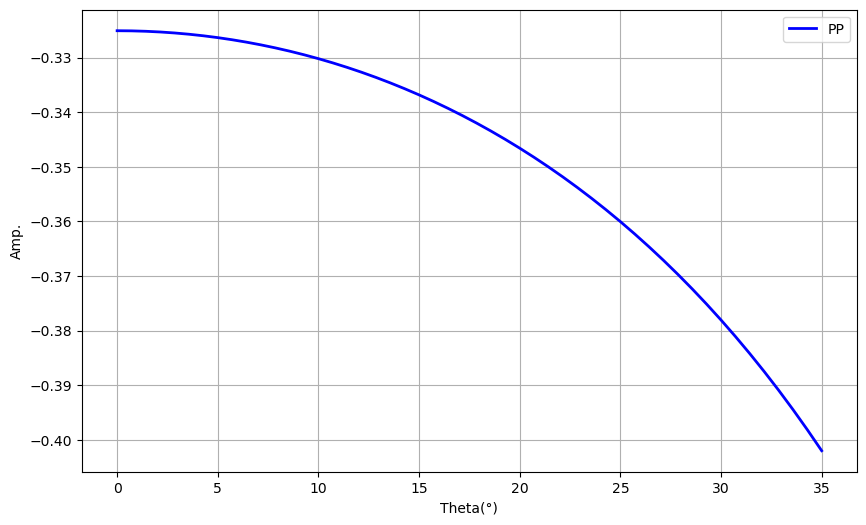

In [15]:
import rockphypy
from rockphypy import AVO

z1 = 820.517  # interface top
z2 = 828.137  # interface bottom

# petrophysical properties
vp1 = log.loc[z1, 'Vp']
vs1 = vp1*0.3
den1 = log.loc[z1, 'RHOB']

vp2 = log.loc[z2, 'Vp']
vs2 = vp2*0.5
den2 = log.loc[z2, 'RHOB']

theta = np.linspace(0, 35, 50)

# Aki-Richards approximation
R_pp, R_ps, Rpp0, gradient = AVO.Aki_Richards(theta, vp1, vp2, vs1, vs2, den1, den2)

plt.figure(figsize=(10, 6))
plt.plot(theta, R_pp, 'b-', lw=2, label='PP')
plt.xlabel('Theta(°)')
plt.ylabel('Amp.')
plt.grid(True)
plt.legend()
plt.show()

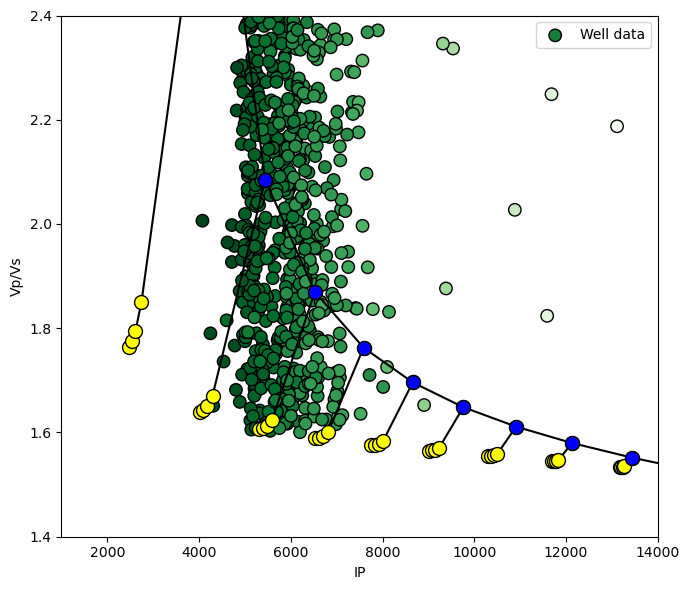

In [16]:
from rockphypy import QI, GM

# params
D0, K0, G0 = 2.65, 37, 38         # Matrix
Kb, Db = 2.5, 1.0                 # bulk
Kg, Dg = 0.05, 0.2                # Gas
phi_c = 0.36
Cn = 8.6
sigma = 20
f = 0                             # f=0 for stiff sand model

# === Grid for RPT ===
phi = np.linspace(0.01, phi_c, 10)
sw = np.linspace(0, 1, 5)

# === Compute dry moduli ===
Kdry, Gdry = GM.stiffsand(K0, G0, phi, phi_c, Cn, sigma, f)

# === Plot RPT (returns matplotlib figure) ===
fig = QI.plot_rpt(Kdry, Gdry, K0, D0, Kb, Db, Kg, Dg, phi, sw)
fig.set_size_inches(7, 6)


# === Calculate IP and PS ===
IP = log_int["Vp"] * log_int["RHOB"]
# PS = log["Vp"] / log["Vs"]
PS = np.random.uniform(low=1.6, high=2.4, size=len(IP))  # in m/s

# === Overlay scatter ===
plt.scatter(IP, PS, c= log_int.Vp, cmap='Greens_r', edgecolors='k', facecolors='none', s=80, label='Well data')
# cbar=plt.colorbar()
plt.xlabel("IP")
plt.ylabel("Vp/Vs")
plt.xlim(1000, 14000)
plt.ylim(1.4, 2.4)
plt.legend()
# plt.grid(True)
plt.tight_layout()
plt.show()



In [17]:
# print("IP min/max:", IP.min(), IP.max())
# print("PS min/max:", PS.min(), PS.max())
# print("PS min/max:", log.Vp.min(), log.Vp.max())